# Investigating Brazilian Nighttime
This is my initial project to investigate Brazilian Nighttime. Here, I used Visible Infrared Imaging Radiometer Suite (VIIRS) Day-Night band (VIIRS DNB), available on Google Earth Engine repository.


In [20]:
import os
import re
import base64
import folium
import rasterio
import matplotlib
import rasterstats
import numpy as np
import pandas as pd
import geopandas as gpd
from folium import IFrame
from itertools import chain
from shapely.wkt import loads
from matplotlib import pyplot as plt
import matplotlib.patches as mpatches

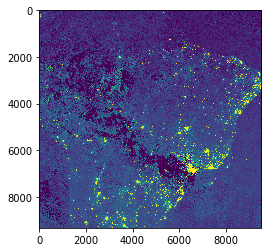

In [3]:
# Looking for rasters
path = 'D:/Programming/Nighttime/images/original/'
rasters = [os.path.join(path + rast) for rast in os.listdir(path)
           if rast.endswith('.tif')]

# Plotting one of the rasters (.tif files)
with rasterio.open(rasters[0]) as src:
    raster = src.read(1, masked=True)
    plt.imshow(raster, vmin=0, vmax=1)


Since the original raster is greater then Brazil's dimension, we need to clip it

Shapefile CRS  {'init': 'epsg:4326'}
Raster CRS  EPSG:31982


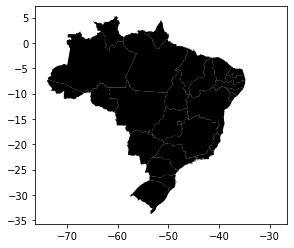

In [4]:
# Adding shapefile
path_shp = r'D:\Programming\Nighttime\shape\EstadosBR_IBGE_LLWGS84.shp'
shapefile = gpd.read_file(path_shp)

# Plotting it
shapefile.plot(color='black')

# However, we should check the Coordinate system of rasters and shapefile
# Shapefile CRS
print('Shapefile CRS ', shapefile.crs)

# Checking raster CRS
with rasterio.open(rasters[0]) as src:
    print('Raster CRS ', src.crs)

Since they are different we need to reproject one of them. Its easier reproject the shapefile

In [5]:
# Rewriting shapefile (changing CRS)
shp = shapefile
shp = shp.to_crs({'init': 'epsg:31982'})
shp.crs

{'init': 'epsg:31982'}

In [ ]:
    def clip_raster_by_shp(img_dir, shp_dir):
        # Loading the shapefile
        with fiona.open(shp_dir, 'r') as shp:
            print('Shape info \n', shp.schema)
            features = [feature['geometry'] for feature in shp]
 
        # Loading raster
        with rasterio.open(img_dir, 'r+') as tif:
            tif.nodata = np.nan
            #  Cropping it using a rasterio mask
            out_image, out_transform = rasterio.mask.mask(tif, features, crop=True, nodata=np.nan)
            
            # Updating profile information
            out_meta = tif.meta.copy()
            print(out_meta)
            # print('Before changes \n', out_meta)
            out_meta.update({'driver': 'GTiff',
                            'height': out_image.shape[1],
                            'width': out_image.shape[2],
                            'transform': out_transform,
                            'compress': 'lzw'
                            })   
            output = output + '_C.tif'
            with rasterio.open(output, 'w', **out_meta) as dest:
                dest.write(out_image) 


# Clipping images
for raster in rasters:
    clip_raster_by_shp(img_dir=raster, shp_dir=shp)

In [6]:
# Let's check if the rasters was correctly clipped
path = 'D:/Programming/Nighttime/images/'
rasters = [os.path.join(path + rast) for rast in os.listdir(path)
           if rast.endswith('.tif')]
rasters

['D:/Programming/Nighttime/images/20180101_C.tif',
 'D:/Programming/Nighttime/images/20180201_C.tif',
 'D:/Programming/Nighttime/images/20180301_C.tif',
 'D:/Programming/Nighttime/images/20180401_C.tif',
 'D:/Programming/Nighttime/images/20180501_C.tif',
 'D:/Programming/Nighttime/images/20180601_C.tif',
 'D:/Programming/Nighttime/images/20180701_C.tif',
 'D:/Programming/Nighttime/images/20180801_C.tif',
 'D:/Programming/Nighttime/images/20180901_C.tif',
 'D:/Programming/Nighttime/images/20181001_C.tif',
 'D:/Programming/Nighttime/images/20181101_C.tif',
 'D:/Programming/Nighttime/images/20181201_C.tif',
 'D:/Programming/Nighttime/images/20190101_C.tif',
 'D:/Programming/Nighttime/images/20190201_C.tif',
 'D:/Programming/Nighttime/images/20190301_C.tif',
 'D:/Programming/Nighttime/images/20190401_C.tif',
 'D:/Programming/Nighttime/images/20190501_C.tif',
 'D:/Programming/Nighttime/images/20190601_C.tif',
 'D:/Programming/Nighttime/images/20190701_C.tif',
 'D:/Programming/Nighttime/imag

In [7]:
# Let's filter this rasters by each year

def filter_years(file):
    date = re.search(r"(\d{3}).", file).group(0)
    return date


# Filtering
rast_2018 = [rast for rast in rasters if '2018' == filter_years(rast)]
rast_2019 = [rast for rast in rasters if '2019' == filter_years(rast)]
rast_2020 = [rast for rast in rasters if '2020' == filter_years(rast)]

# Checking number of raster per year
print(f'rast_2018 count: {len(rast_2018)} \n rast_2019 count: {len(rast_2019)}  \n rast_2020 count: {len(rast_2020)}')

rast_2018 count: 12 
 rast_2019 count: 12  
 rast_2020 count: 1


# Data Visualization
With all years we can extract some interesting patterns from them.
Since we only have one file available to 2019, I will plot this separately.

TODO: Plotar histogramas, media + std

Arrumar a escala do histograma

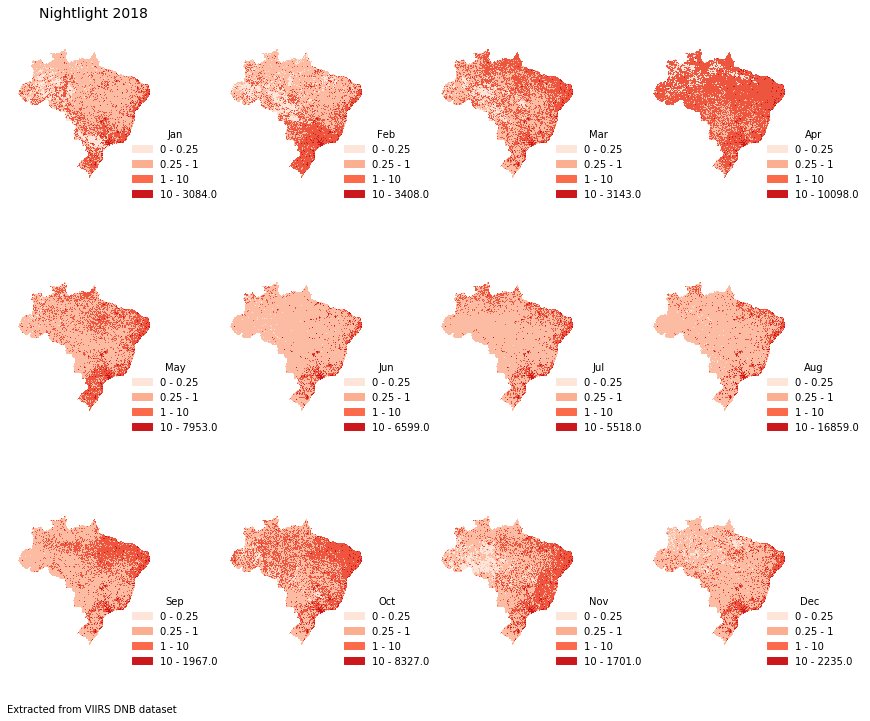

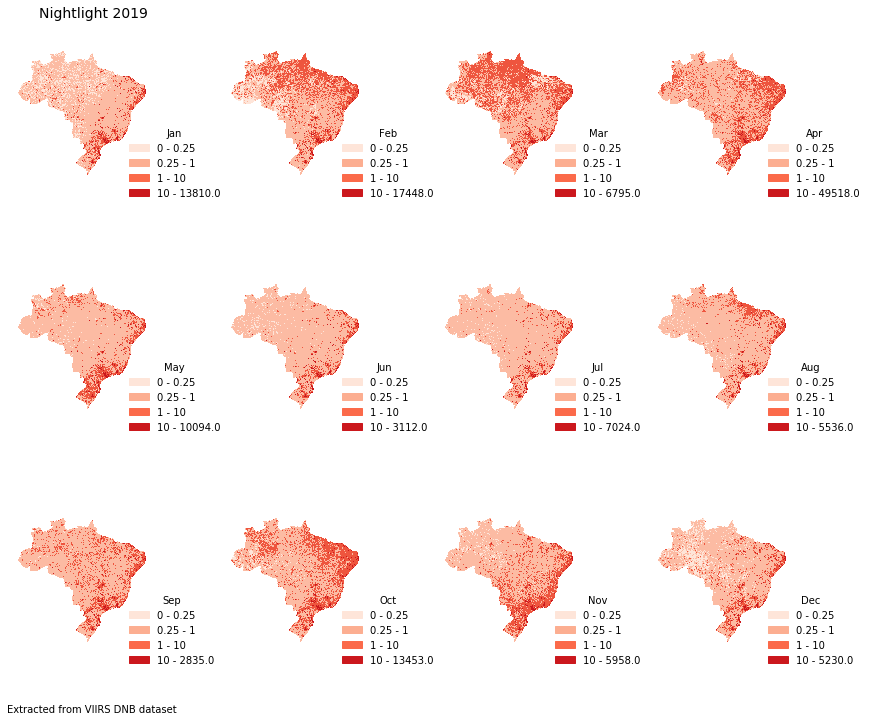

In [7]:
# Plotting years
# Creating a colormap from specific colors
colors = ['#fee5d9', '#fcae91', '#fb6a4a', '#cb181d']
cmap = matplotlib.colors.LinearSegmentedColormap.from_list(name="new cmap",
                                                           colors=colors,
                                                           N=5)

# Defining months names to add on figure
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct',
          'Nov', 'Dec']

# Reading each raster and plotting
for year, year_name in zip([rast_2018, rast_2019], ['2018', '2019']):
    # Creating a figure
    fig, axes = plt.subplots(ncols=4, nrows=3, figsize=(12, 10))
    axes = axes.flatten()
    for raster, ax, month in zip(year, axes, months):

        # Open and read raster
        with rasterio.open(raster) as src:
            tif = src.read(1)

        # Replacing negative values
        tif[np.where(tif < 0)] = 0

        # Specyfing classes to reclassify raster
        bins = [0, 0.25, 1, 10, np.round(np.nanmax(tif), 0)]

        tif_reclass = np.copy(tif)
        tif_reclass[np.where(np.isnan(tif_reclass))] = -999
        tif_reclass[np.where((tif_reclass > bins[3]))] = 4
        tif_reclass[np.where((tif_reclass > bins[2]) & (tif_reclass <= bins[3]))] = 3
        tif_reclass[np.where((tif_reclass > bins[1]) & (tif_reclass <= bins[2]))] = 2
        tif_reclass[np.where((tif_reclass > bins[0]) & (tif_reclass <= bins[1]))] = 1

        # Masking nan values
        tif_masked = np.ma.masked_where(tif_reclass == -999, tif_reclass, 
                                        copy=True)

        # Plotting
        plot = ax.imshow(tif_masked, cmap=cmap)

        # Creating patches for legend
        patches = [mpatches.Patch(color=colors[i], 
                                label=f'{str(bins[i])} - {str(bins[i+1])}') 

                                        for i in range(len(bins)-1)]
        ax.legend(handles=patches, bbox_to_anchor=(0.8, 0.45), 
                loc=2, frameon=False, title=f'{month}')
        ax.axis('off')

    # Configuring figure
    fig.tight_layout()
    fig.text(0.0, 0.0, 'Extracted from VIIRS DNB dataset', ha='left', fontsize=10)
    fig.suptitle(f'Nightlight {year_name}', fontsize=14, x=0.1, y=0.98)
    fig.savefig(f'./{year_name}_nightlight.png', dpi=300)

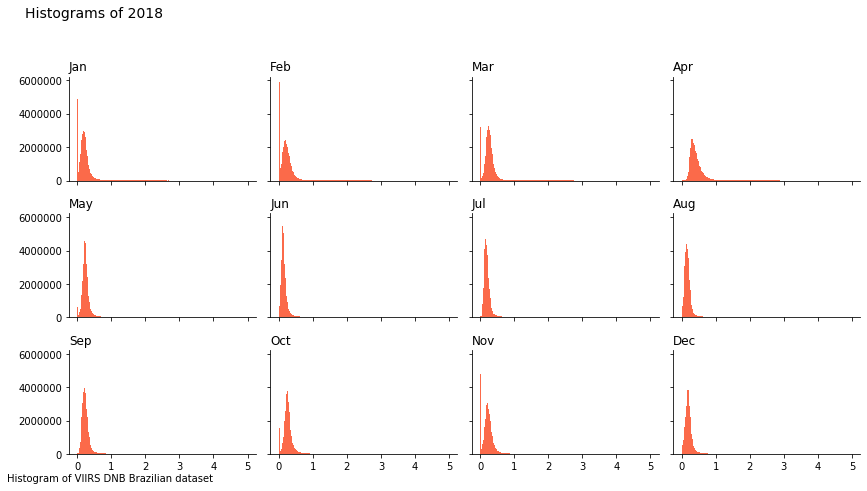

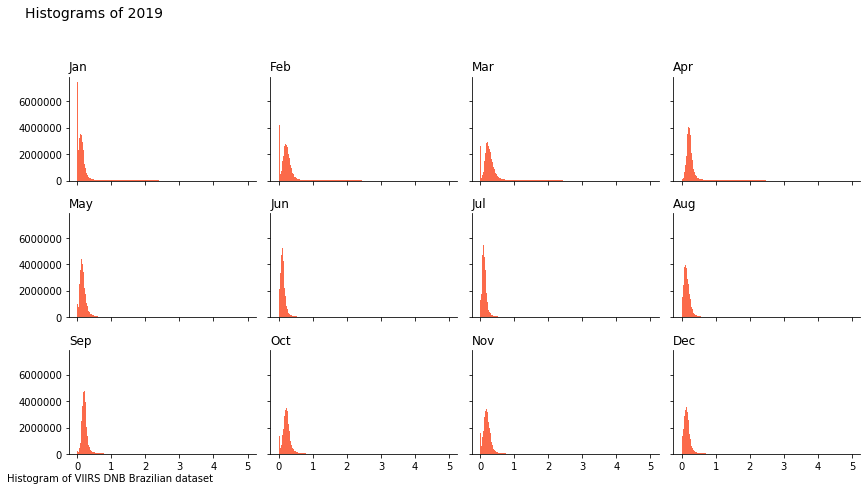

In [8]:
# Plotting histograms
for year, year_name in zip([rast_2018, rast_2019], ['2018', '2019']):
    # Creating a figure
    fig, axes = plt.subplots(ncols=4, nrows=3, figsize=(12, 6), sharex= True, sharey=True)
    axes = axes.flatten()

    for raster, month, ax in zip(year, months, axes):

        # Open and reading raster
        with rasterio.open(raster) as src:
            tif = src.read(1, masked=True)

        # Replacing negative values as 0
        tif[np.where(tif < 0)] = 0

        # Removing nan values and flatten the array
        tif = tif[np.logical_not(np.isnan(tif))]
        tif = tif.flatten()

        # Plotting
        ax.hist(tif, bins=250, range=(0, 5), color='#fb6a4a')
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.set_title(f'{month}', loc='left')
    
    # Configuring figure
    fig.tight_layout()
    fig.suptitle(f'Histograms of {year_name}', fontsize=14, x=0.1, y=1.1)
    fig.text(0.0, 0.0, 'Histogram of VIIRS DNB Brazilian dataset', ha='left', fontsize=10)
    fig.savefig(f'./{year_name}_nightlight.png', dpi=300)

# Shapefile Section

In [8]:
# Checking shapefile
shp.head(5)

,object_id_,ESTADO,agreount_,REGION,geometry
0,1,AC,22.0,NO,"POLYGON ((-2067754.963 9069246.931, -2068941.1..."
1,10,MA,288.0,SE,"MULTIPOLYGON (((1072317.129 9860211.591, 10727..."
2,11,MG,853.0,SUD,"POLYGON ((496436.034 7811616.348, 495822.503 7..."
3,12,MS,77.0,CO,"POLYGON ((-211806.248 7669718.746, -213167.415..."
4,13,MT,139.0,CO,"POLYGON ((-672216.995 8951251.225, -671702.891..."


In [9]:
# Drop unnecessary columns
shp = shp.drop(['object_id_', 'agreount_'], axis='columns')

# Create a new column to get BR outline
shp['BR'] = 0
shp_br_outline = shp.dissolve(by='BR')

# Also, create a list with regions and states name
states_name = shp['ESTADO'].to_list()
regions_name = shp['REGION'].to_list()

shp.head(5)

,ESTADO,REGION,geometry,BR
0,AC,NO,"POLYGON ((-2067754.963 9069246.931, -2068941.1...",0
1,MA,SE,"MULTIPOLYGON (((1072317.129 9860211.591, 10727...",0
2,MG,SUD,"POLYGON ((496436.034 7811616.348, 495822.503 7...",0
3,MS,CO,"POLYGON ((-211806.248 7669718.746, -213167.415...",0
4,MT,CO,"POLYGON ((-672216.995 8951251.225, -671702.891...",0


## Extracting pixels values by state
To extract the radiance values for each state (or for Brazil) it would be required a Zonal Statistics, which basically will extract common descriptive statistics (min, max, mean, meadian, etc.) to a specific geometry. This can be achieved with **rasterstats** package.

In [50]:
# Since we have one image per month, lets create a list with all months
# This to create a dataframe with month as indexers
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct',
          'Nov', 'Dec']
# Performing Raster Zonal Statistics


def variance(array):
    return np.nanvar(array)


def zonal_stats(rasters_list):
    statelst, brlst = [], []
    for raster in rasters_list:
        with rasterio.open(raster) as src:

            # rasterio.plot.show(tif, vmin=0, vmax=10, cmap='inferno')
            affine = src.transform

            # removing background values (<0)
            tif = src.read(1, masked=True)
            tif[tif < 0] = 0

            info_state = rasterstats.zonal_stats(shp, tif, affine=affine,
                                                 stats=['min', 'max', 'mean',
                                                        'median', 'majority',
                                                        'minority', 'count',
                                                        'std'],
                                                 add_stats={'variace': variance},
                                                 nodata=np.nan)

            info_br = rasterstats.zonal_stats(shp_br_outline, tif,
                                              affine=affine,
                                              stats=['min', 'max', 'mean',
                                                     'median', 'majority',
                                                     'minority', 'count',
                                                     'std'],
                                              add_stats={'variace': variance},
                                              nodata=np.nan)

            statelst.append(pd.DataFrame(info_state, index=states_name))
            brlst.append(info_br)
            statelst

    year_df = pd.DataFrame(list(chain.from_iterable(brlst)), index=months)
    state_df = pd.concat(statelst, keys=months)

    return state_df, year_df


In [51]:
# Executing Raster Zonal Stats
state2018, year2018 = zonal_stats(rast_2018)
state2019, year2019 = zonal_stats(rast_2019)
state2020, year2020 = zonal_stats(rast_2020)

# Creating lists of  dataframes
dfs_states = [state2018, state2019, state2020]
name_states = ['state2018', 'state2019', 'state2020']

dfs_years = [year2018, year2019, year2020]
name_years = ['year2018', 'year2019', 'year2020']

# Checking state the output
state2018.head(7)

min          max      mean    count        std  median  majority  \
Jan AC  0.00    80.540001  0.234969   796075   1.096166    0.19      0.00   
    MA  0.00   104.800003  0.262149  1557523   1.526077    0.15      0.13   
    MG  0.00   305.809998  0.500505  2757920   2.309570    0.25      0.22   
    MS  0.00  3084.020020  0.255223  1666164   5.521721    0.22      0.00   
    MT  0.00   194.559998  0.235511  4234237   1.000542    0.20      0.00   
...      ...          ...       ...      ...        ...     ...       ...   
Dec BA  0.00  1184.709961  0.392118  2693423   2.299390    0.21      0.20   
    CE  0.00   282.769989  0.576883   719104   2.649732    0.26      0.23   
    DF  0.05   200.669998  8.100884    27046  19.612600    0.88      0.30   
    ES  0.00  1461.020020  1.049460   220240   6.311871    0.28      0.24   
    GO  0.00   125.730003  0.360753  1581215   2.207428    0.17      0.16   

        minority     variace  
Jan AC      2.19    1.201580  
    MA      5.81    2.328912  
    MG     19.25    5.334115  
    MS      3.20   30.489403  
    MT      6.22    1.001084  
...          ...         ...  
Dec BA     11.41    5.287193  
    CE      7.84    7.021080  
    DF      0.05  384.654095  
    ES      5.60   39.839716  
    GO      9.25    4.872739  

[324 rows x 9 columns]

In [11]:
# However, the multiple indexes on states dataframes don't have a name
# So, let's correct this
for df in dfs_states:
    df.index.names = ['month', 'state']
    print(df.head(2))

NameError: name 'dfs_states' is not defined

In [53]:
# Checking year output
year2018.head(5)

,min,max,mean,count,std,median,majority,minority,variace
Jan,0.0,3084.020020,0.348720,40521772,2.530834,0.18,0.00,44.509998,6.405120
Feb,0.0,3407.889893,0.369466,40521772,2.746355,0.19,0.00,55.790001,7.542468
Mar,0.0,3143.320068,0.427049,40521772,2.609342,0.25,0.00,55.380001,6.808668
Apr,0.0,10098.099609,0.550640,40521772,4.141862,0.36,0.00,58.549999,17.155021
May,0.0,7953.370117,0.428623,40521772,3.505143,0.22,0.21,56.180000,12.286028
Jun,0.0,6599.109863,0.329670,40521772,3.123164,0.13,0.11,61.240002,9.754156
Jul,0.0,5518.319824,0.394537,40521772,3.192095,0.18,0.16,60.990002,10.189468
Aug,0.0,16859.119141,0.367520,40521772,5.912974,0.15,0.13,61.810001,34.963262
Sep,0.0,1967.339966,0.431461,40521772,2.757456,0.22,0.19,60.380001,7.603566
Oct,0.0,8327.080078,0.437253,40521772,3.106494,0.25,0.25,57.279999,9.650308


In [54]:
# Now, we can merge states and years dataframes with shapefile info
for df, name in zip(dfs_states, name_states):
    df_merge = pd.merge(df, shp, left_on='state', right_on='ESTADO')
    df_merge.to_csv(f'./Nighttime/code/dataframes/{name}.csv')

# Saving it
for df, name in zip(dfs_years, name_years):
    df.to_csv(f'.\{name}.csv')

In [23]:
# Let's check our dataframe
state2018 = pd.read_csv(f'D:/Programming/Nighttime/code/dataframes/state2018.csv') 
state2018.head(5)

,Unnamed: 0,min,max,mean,count,std,median,majority,minority,variace,ESTADO,REGION,geometry,BR
0,0,0.0,80.540001,0.234969,796075,1.096166,0.19,0.00,2.19,1.201580,AC,NO,POLYGON ((-2067754.963175996 9069246.931215286...,0
1,1,0.0,89.989998,0.197211,796075,0.701915,0.18,0.00,2.24,0.492684,AC,NO,POLYGON ((-2067754.963175996 9069246.931215286...,0
2,2,0.0,100.080002,0.232246,796075,0.993401,0.20,0.00,1.91,0.986847,AC,NO,POLYGON ((-2067754.963175996 9069246.931215286...,0
3,3,0.0,76.949997,0.368301,796075,0.789968,0.33,0.32,0.03,0.624049,AC,NO,POLYGON ((-2067754.963175996 9069246.931215286...,0
4,4,0.0,98.690002,0.205407,796075,1.024751,0.16,0.16,2.65,1.050114,AC,NO,POLYGON ((-2067754.963175996 9069246.931215286...,0


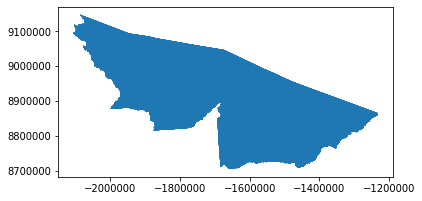

In [24]:
# Transforming a pandas dataframe to a geodataframe
gdf = gpd.GeoDataFrame(state2018)

# Since they dont have any Coordinate System we should assign it
gdf.crs = {'init': 'epsg:31982'}  # original coordinate system from shapefile

# However, geopandas needs a geometry column to retrieve coordinates
# Let's do this with shapely wtk.load function
gdf['geometry'] = gdf['geometry'].apply(loads)

# Getting a state geometry to plor
gdf.loc[0:11, :].plot()

In [25]:
# Since everything is working fine, let's chage the coordinate system
gdf = gdf.to_crs('epsg:4326')  # folium only interpret EPSG 4326
gdf.crs


'epsg:4326'

In [29]:
# Our dataset has all brazilian states
# To facilitate our future work, let's split the datasets


def states_geodataframe(geodataframe, states_list):
    ''' Create multiple state shapefiles from a geodataframe'''
    gdfs = []
    for state in states_list:
        gdf = geodataframe[geodataframe['ESTADO'] == state]
        gdfs.append(gdf)

    return gdfs


gdfs = states_geodataframe(gdf, states_name)
print('How many states geodataframes we have? ', len(gdfs))

How many states geodataframes we have?  27


In [36]:
# Let's create an interactive map

basemap = folium.Map(location=(-15, -50), zoom_start=5)
style = {'fillColor': '#00FFFFFF', 'lineColor': '#42f551'}

# Adding Brazil and state geometry
# folium.GeoJson(shp_br_outline.geometry).add_to(basemap)
for state, name in zip(gdfs, states_name):
    centroid_coords = state['geometry'].centroid
    centroid_coords_y = centroid_coords.iloc[0].y
    centroid_coords_x = centroid_coords.iloc[0].x

    # Adding Brazil and state geometry
    folium.GeoJson(state.geometry).add_to(basemap)

    # Adding a figure as a marker

    png = f'./images/{name}_stats.png'
    encoded = base64.b64encode(open(png, 'rb').read())
    html = '<img src="data:image/png;base64,{}">'.format
    iframe = IFrame(html(encoded.decode('UTF-8')), width=(100*4.4), 
                    height=(100*3.5))
    popup = folium.Popup(iframe, max_width=2650)

    icon = folium.Icon(color="red", icon="ok")
    marker = folium.Marker([centroid_coords_y, centroid_coords_x],
                           popup=popup, icon=icon)
    marker.add_to(basemap)

basemap